In [ ]:
!unzip dataset.zip

Archive:  dataset.zip
   creating: dataset/
 extracting: dataset/code.ipynb      
   creating: dataset/dataset/
  inflating: dataset/dataset/2.jpg   
  inflating: dataset/dataset/ref_image.jpg  
  inflating: dataset/dataset/WhatsApp Image 2024-10-19 at 1.18.05 AM.jpeg  
  inflating: dataset/dataset/WhatsApp Image 2024-10-19 at 1.18.07 AM.jpeg  
  inflating: dataset/dataset/WhatsApp Image 2024-10-19 at 1.18.15 AM.jpeg  
  inflating: dataset/dataset/WhatsApp Image 2024-10-19 at 1.18.17 AM (1).jpeg  
  inflating: dataset/dataset/WhatsApp Image 2024-10-19 at 1.18.17 AM (2).jpeg  
  inflating: dataset/dataset/WhatsApp Image 2024-10-19 at 1.18.17 AM.jpeg  
  inflating: dataset/dataset/WhatsApp Image 2024-10-19 at 1.18.18 AM.jpeg  
  inflating: dataset/ref_image.jpg   


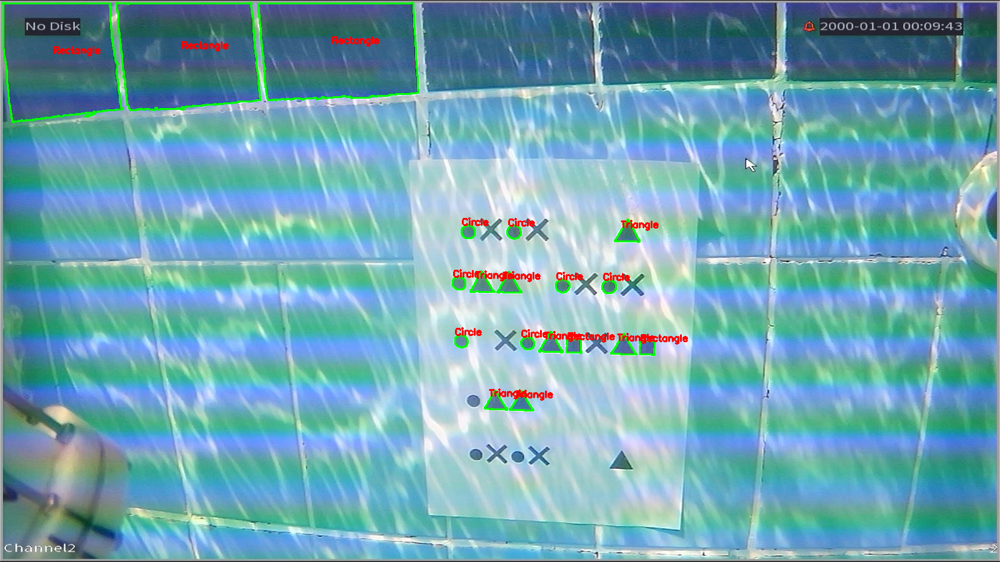

Detected Shapes in WhatsApp Image 2024-10-19 at 1.18.17 AM (1).jpeg


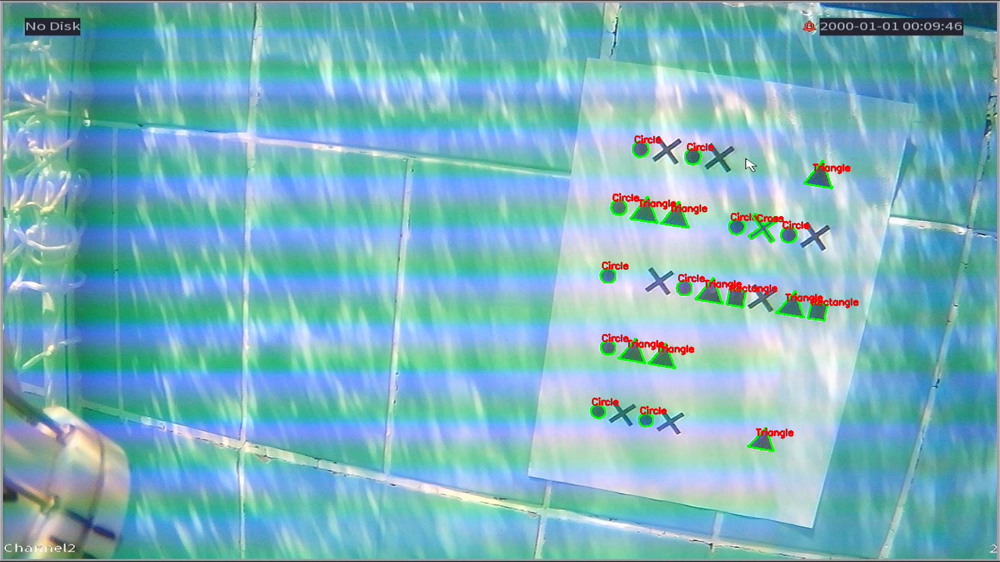

Detected Shapes in WhatsApp Image 2024-10-19 at 1.18.18 AM.jpeg


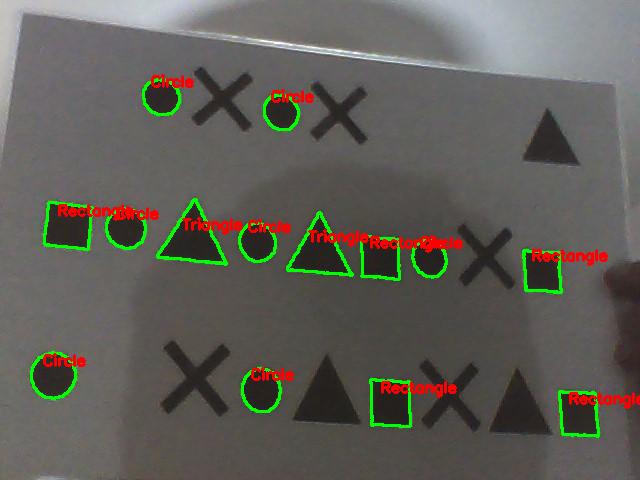

Detected Shapes in 2.jpg


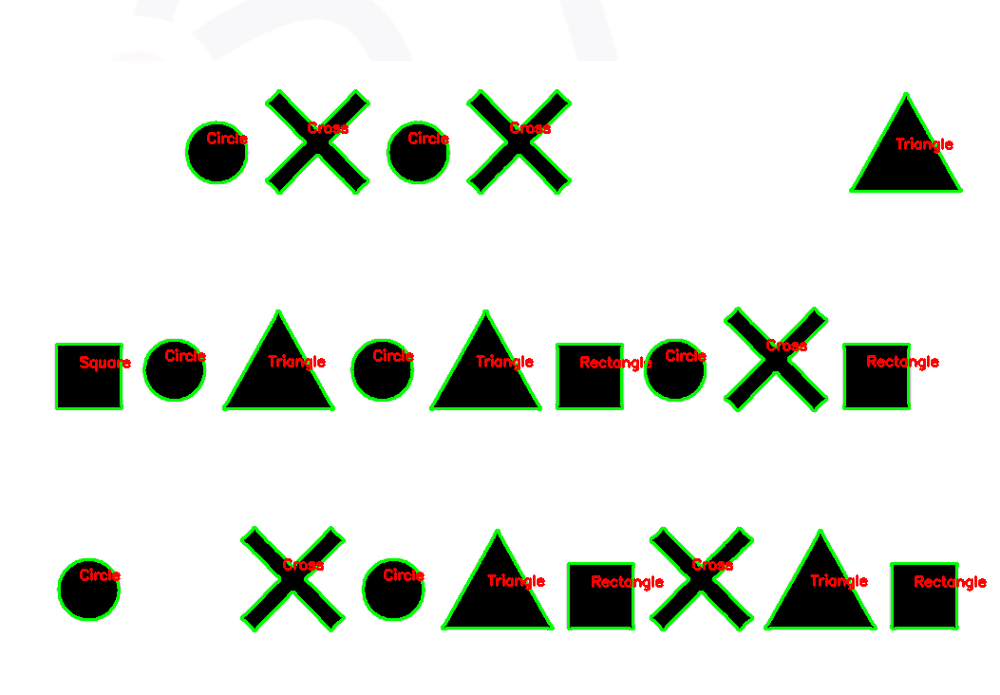

Detected Shapes in ref_image.jpg


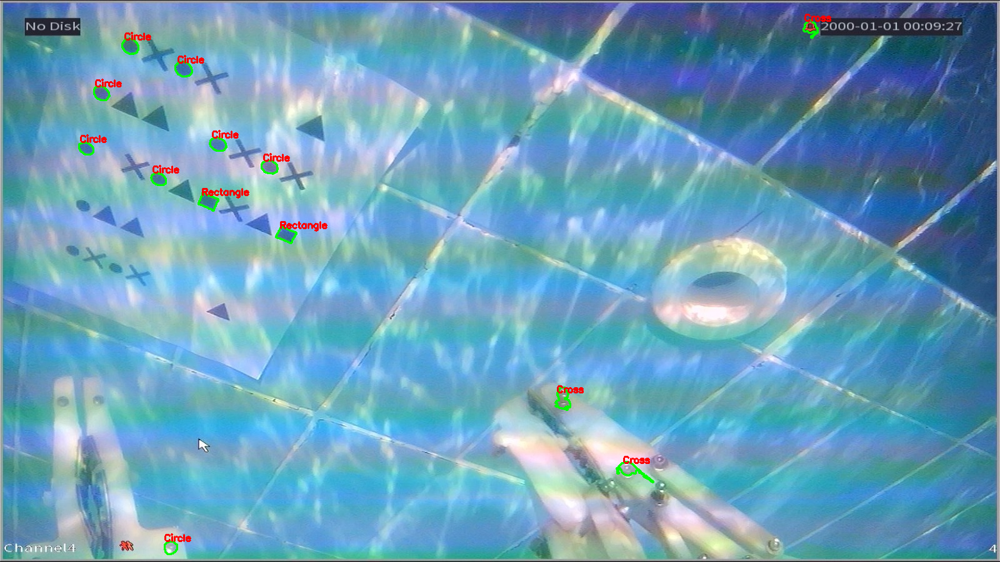

Detected Shapes in WhatsApp Image 2024-10-19 at 1.18.05 AM.jpeg


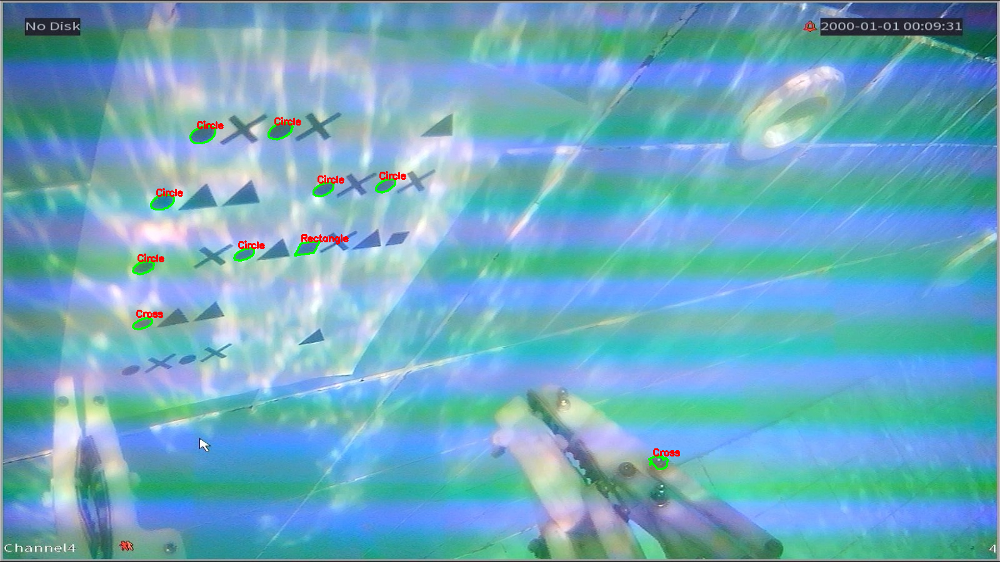

Detected Shapes in WhatsApp Image 2024-10-19 at 1.18.15 AM.jpeg


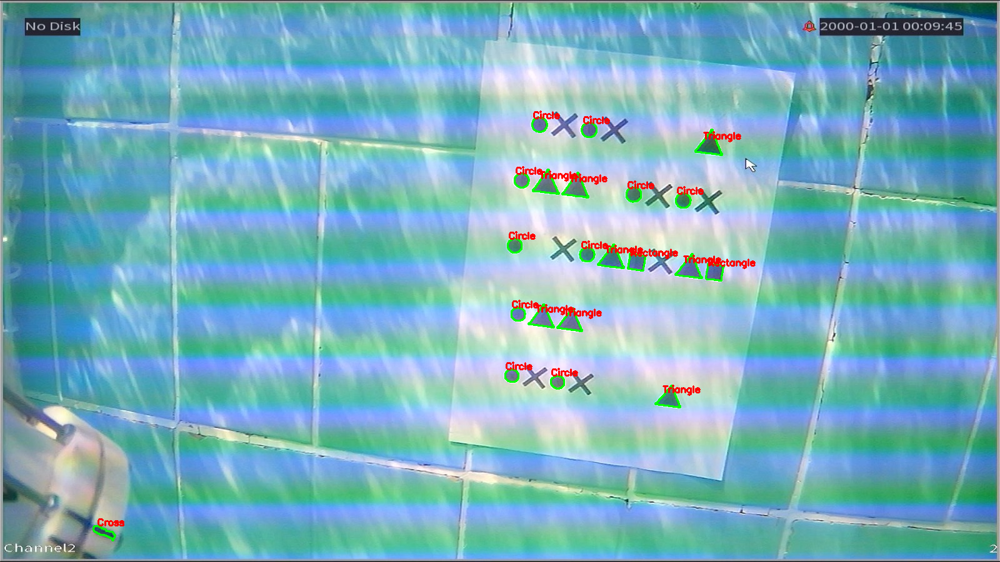

Detected Shapes in WhatsApp Image 2024-10-19 at 1.18.17 AM (2).jpeg


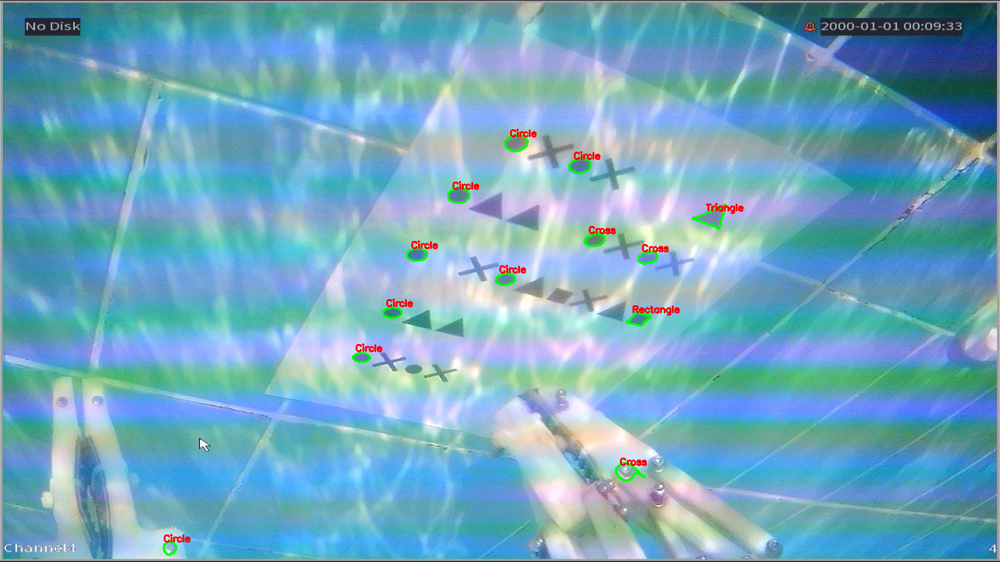

Detected Shapes in WhatsApp Image 2024-10-19 at 1.18.17 AM.jpeg


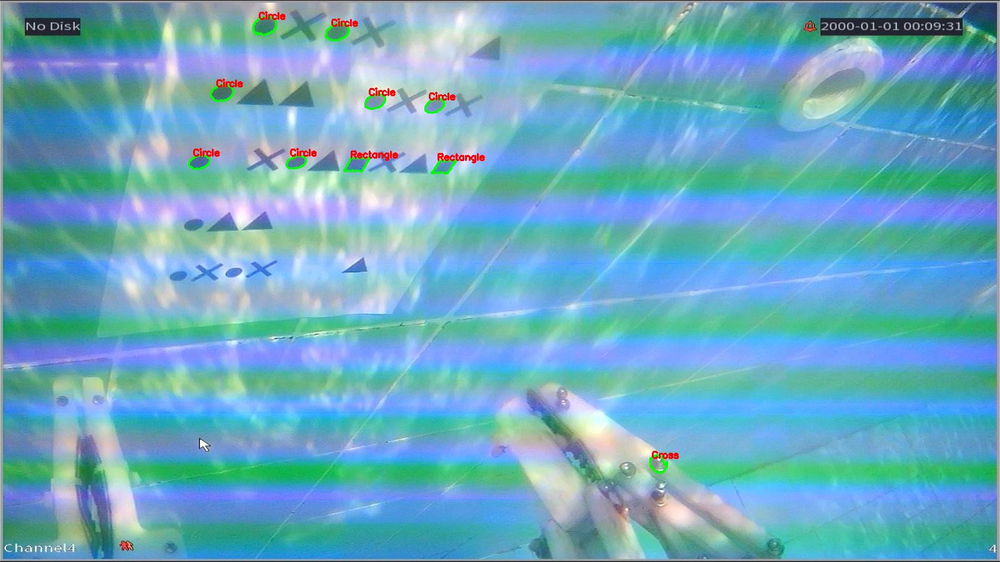

Detected Shapes in WhatsApp Image 2024-10-19 at 1.18.07 AM.jpeg


In [24]:
import cv2
import numpy as np
import os
from google.colab.patches import cv2_imshow

# Load the reference image
reference_image = cv2.imread('/content/dataset/ref_image.jpg')

# Convert reference image to grayscale and preprocess
ref_gray = cv2.cvtColor(reference_image, cv2.COLOR_BGR2GRAY)
ref_blurred = cv2.GaussianBlur(ref_gray, (5, 5), 0)

# Use adaptive thresholding instead of Canny edge detection
ref_edges = cv2.adaptiveThreshold(ref_blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                   cv2.THRESH_BINARY_INV, 11, 2)

ref_contours, _ = cv2.findContours(ref_edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Directory containing images to test
image_directory = '/content/dataset/dataset'

# Set a minimum contour area threshold
MIN_CONTOUR_AREA = 300  # Adjust this value based on your needs

def get_shape_name(contour):
    """Determine the shape name by analyzing the contour."""
    perimeter = cv2.arcLength(contour, True)
    approx = cv2.approxPolyDP(contour, 0.03 * perimeter, True)

    if len(approx) == 3:
        return "Triangle"
    elif len(approx) == 4:
        aspect_ratio = cv2.contourArea(contour) / (cv2.boundingRect(contour)[2] * cv2.boundingRect(contour)[3])
        return "Square" if 0.95 <= aspect_ratio <= 1.05 else "Rectangle"
    elif len(approx) > 4:
        circularity = (4 * np.pi * cv2.contourArea(contour)) / (perimeter * perimeter)
        if circularity > 0.7:
            return "Circle"
        else:
            return "Cross"
    return "Unknown"

def match_shapes(ref_contours, target_image):
    # Convert target image to grayscale and preprocess
    target_gray = cv2.cvtColor(target_image, cv2.COLOR_BGR2GRAY)
    target_blurred = cv2.GaussianBlur(target_gray, (5, 5), 0)

    # Use adaptive thresholding instead of Canny edge detection
    target_edges = cv2.adaptiveThreshold(target_blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                          cv2.THRESH_BINARY_INV, 11, 2)

    target_contours, _ = cv2.findContours(target_edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Match shapes
    for target in target_contours:
        # Check the area of the contour
        if cv2.contourArea(target) < MIN_CONTOUR_AREA:
            continue  # Skip small contours

        for reference in ref_contours:
            match = cv2.matchShapes(reference, target, cv2.CONTOURS_MATCH_I1, 0.0)
            if match < 0.1:  # Adjust this threshold based on your needs
                # Draw matches on the target image
                cv2.drawContours(target_image, [target], -1, (0, 255, 0), 2)  # Green color for detected shapes

                # Get the centroid to place the text
                M = cv2.moments(target)
                if M["m00"] != 0:
                    cX = int(M["m10"] / M["m00"])
                    cY = int(M["m01"] / M["m00"])

                    # Determine the shape name
                    shape_name = get_shape_name(target)

                    # Place the shape name above the shape
                    cv2.putText(target_image, shape_name, (cX - 10, cY - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)  # Red color for text

                break
    return target_image

# Loop through all images in the directory
for filename in os.listdir(image_directory):
    if filename.endswith(('.jpg', '.jpeg', '.png')):  # Add other image formats if needed
        image_path = os.path.join(image_directory, filename)
        target_image = cv2.imread(image_path)

        # Check if the image was loaded
        if target_image is not None:
            # Match shapes and get the result
            result_image = match_shapes(ref_contours, target_image)

            # Display the result
            cv2_imshow(result_image)  # Only pass the image to cv2_imshow
            print(f'Detected Shapes in {filename}')
            cv2.waitKey(0)

cv2.destroyAllWindows()
